In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score
import matplotlib.pyplot as plt
from sklearn.utils import resample
from featurewiz import FeatureWiz

Imported lazytransform v1.9. 

Imported featurewiz 0.5.1. Use the following syntax:
    >>> wiz = FeatureWiz(feature_engg = '', nrows=None, transform_target=True, scalers="std",
        		category_encoders="auto", add_missing=False, verbose=0. imbalanced=False,
        		ae_options={})
    >>> X_train_selected, y_train = wiz.fit_transform(X_train, y_train)
    >>> X_test_selected = wiz.transform(X_test)
    >>> selected_features = wiz.features
    


In [2]:
gene_expression = pd.read_csv("data/proteomics.csv")

In [6]:
# Split the data into training and testing sets based on Subject ID and equalize the classes
# Split data based on 'Subject_ID' to keep all records of a subject together
subject_ids = gene_expression['Subject_ID'].unique()
train_ids, test_ids = train_test_split(subject_ids, test_size=0.2, random_state=73)

train = gene_expression[gene_expression['Subject_ID'].isin(train_ids)]
test = gene_expression[gene_expression['Subject_ID'].isin(test_ids)]

# To balance the classes, you may resample the training data
# Here is an example to balance the training set by upsampling the minority classes

# Count class instances
class_counts = train['Diagnosis'].value_counts()

# Find the maximum count to match other classes
max_class_count = class_counts.max()

# Resample each class to have the same number of samples as the max class count
train_balanced = pd.DataFrame()
for class_index in class_counts.index:
    class_subset = train[train['Diagnosis'] == class_index]
    resampled_subset = resample(class_subset,
                                replace=True,  # sample with replacement
                                n_samples=max_class_count,  # to match majority class
                                random_state=42)  # reproducible results
    train_balanced = pd.concat([train_balanced, resampled_subset])

# Update X_train, y_train from the balanced dataset
X_train = train_balanced.drop(["Diagnosis", "Subject_ID"], axis=1)
y_train = train_balanced["Diagnosis"].replace({"AD": 1, "CTL": 0, "MCI": 2})

X_test = test.drop(["Diagnosis", "Subject_ID"], axis=1)
y_test = test["Diagnosis"].replace({"AD": 1, "CTL": 0, "MCI": 2})

In [12]:
X_train

,Sex,Age,APOE,MMSE,0..gjSdbqnr.rUSTBI,0.PRu.vXrqQjlN4p9I,00K3OeGXV631V5_6eA,00buPhOysV5Rpc5VF4,0106ep0.a1f3X61SF8,01BXNAw4H3SIpN6rXo,...,xu.S6OENiSSCDruXFc,xu3n8ix_RpCpNPRKhc,xuBm5ckgidWRNTl.gQ,xuNOUeR1JerhIuIV7c,xud4v2r3nXECBua55o,xvHfVEL1fC35XJ7neU,xve7nuGHtAizelOmhE,xvrrv4q_nIDgJej.uU,xws9e3UChad1OnXmXY,xz1S1tKD.sgqfTuesU
308,0,71.000000,2,0.966667,0.373462,0.272052,0.248092,0.203327,0.148648,0.352946,...,0.267395,0.474005,0.322278,0.312861,0.230009,0.252930,0.222300,0.324855,0.274782,0.366933
611,0,65.000000,0,1.000000,0.791738,0.664954,0.846317,0.704046,0.797114,0.659432,...,0.721021,0.682399,0.839889,0.838115,0.726353,0.758462,0.808803,0.767809,0.875603,0.749135
297,0,73.000000,3,1.000000,0.753991,0.806894,0.713359,0.795444,0.863695,0.780309,...,0.713548,0.701145,0.733227,0.763021,0.584077,0.829677,0.963492,0.779744,0.874039,0.567320
38,0,75.081911,0,0.766667,0.236297,0.213174,0.190480,0.220645,0.205450,0.517569,...,0.356757,0.404757,0.200353,0.257424,0.349595,0.282371,0.272161,0.335460,0.268085,0.266772
312,0,77.000000,2,0.966667,0.278146,0.254306,0.202703,0.231148,0.080339,0.391745,...,0.208152,0.383083,0.331151,0.260068,0.154107,0.036260,0.275670,0.462707,0.212829,0.301858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624,0,78.000000,2,0.933333,0.763209,0.693383,0.927534,0.837662,0.845961,0.578578,...,0.766239,0.785488,0.748705,0.895304,0.904220,0.824477,0.681904,0.496628,0.849875,0.762054
562,0,69.000000,0,0.900000,0.299200,0.159331,0.260117,0.326403,0.189123,0.351844,...,0.323805,0.451531,0.399997,0.315779,0.435424,0.370741,0.209675,0.138885,0.213966,0.460925
567,1,81.000000,2,0.900000,0.656041,0.782451,0.895536,0.947970,0.907603,0.544891,...,0.739526,0.673209,0.584618,0.753290,0.809192,0.875257,0.846116,0.642359,0.818849,0.663681
243,1,78.000000,2,0.833333,0.748460,0.801015,0.851050,0.885596,0.908946,0.676013,...,0.699020,0.786724,0.660805,0.778019,0.823342,0.938775,0.681461,0.583508,0.841504,0.756493


############################################################################################
############       F A S T   F E A T U R E  E N G G    A N D    S E L E C T I O N ! ########
# Be judicious with featurewiz. Don't use it to create too many un-interpretable features! #
############################################################################################
featurewiz has selected 0.7 as the correlation limit. Change this limit to fit your needs...
    Skipping feature engineering since no feature_engg input...
Skipping category encoding since no category encoders specified in input...
    Single_Label Multi_Classification problem 
    Loaded train data. Shape = (898, 1022)
    Some column names had special characters which were removed...
    Single_Label Multi_Classification problem 
No test data filename given...
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  #####

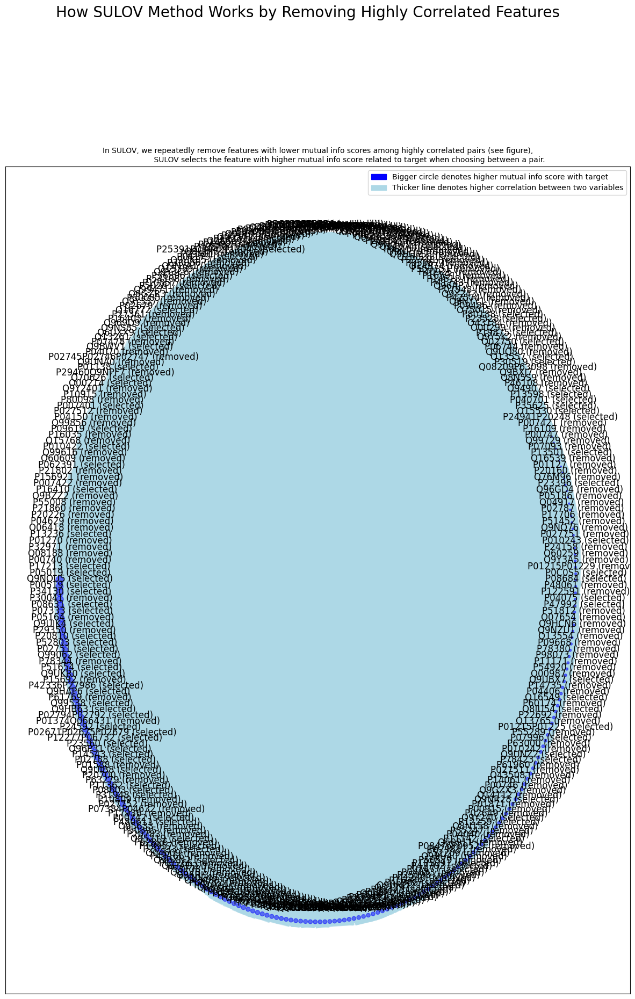

Time taken for SULOV method = 4 seconds
    Adding 2 categorical variables to reduced numeric variables  of 796
Finally 798 vars selected after SULOV
Converting all features to numeric before sending to XGBoost...
    there were no mixed data types or object columns that errored. Data is all numeric...
Shape of train data after adding missing values flags = (898, 801)
#######################################################################################
#####    R E C U R S I V E   X G B O O S T : F E A T U R E   S E L E C T I O N  #######
#######################################################################################
    using regular XGBoost
    Taking top 160 features per iteration...
    Number of booster rounds = 100
            Time taken for regular XGBoost feature selection = 1 seconds
            Time taken for regular XGBoost feature selection = 1 seconds
            Time taken for regular XGBoost feature selection = 1 seconds
            Time taken for regular XGBoo

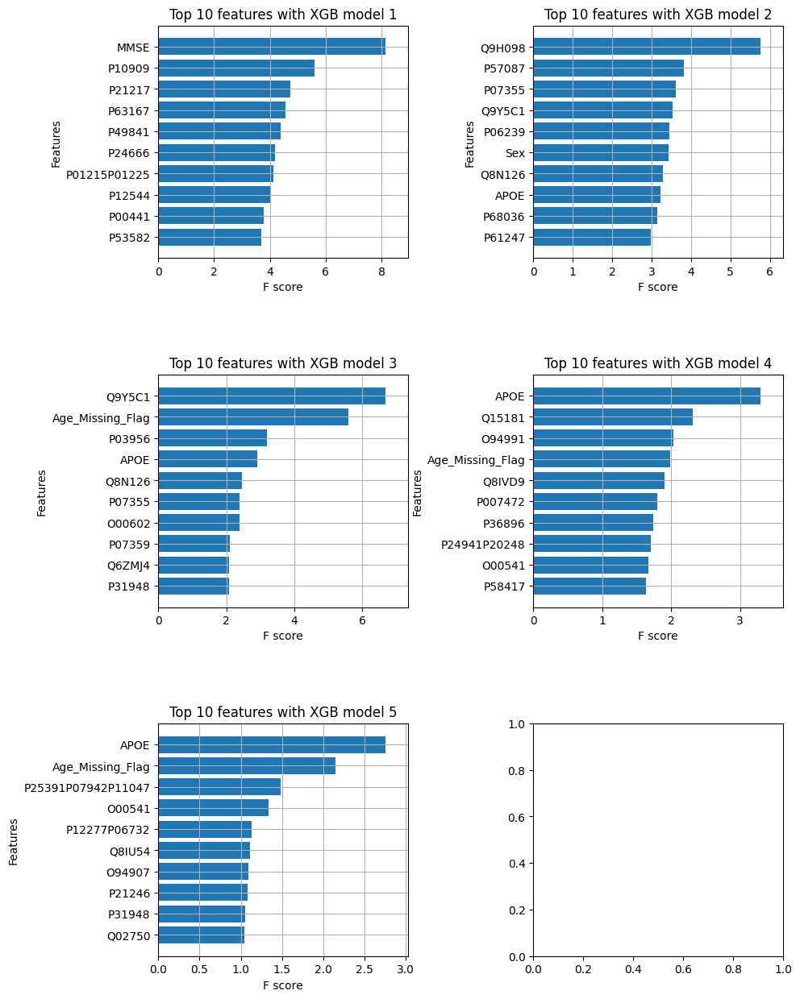

    Completed XGBoost feature selection in 6 seconds
#######################################################################################
#####          F E A T U R E   S E L E C T I O N   C O M P L E T E D            #######
#######################################################################################
Alert: Dont forget to add a missing flag to Age to create Age_Missing_Flag column
Selected 453 important features. Too many to print...
Total Time taken for featurewiz selection = 9 seconds
Output contains a list of 453 important features and a train dataframe


In [3]:
import featurewiz as fwiz
outputs = fwiz.featurewiz(dataname=gene_expression, target="Diagnosis", corr_limit=0.70, verbose=2, sep=',', 
		header=0, test_data='',feature_engg='', category_encoders='',
		dask_xgboost_flag=False, nrows=None, skip_sulov=False, skip_xgboost=False)

In [4]:
#get list of selected features
selected_data = outputs[1]

In [5]:
selected_data

,P01008,Q9UHL4,Q06323,P03952,Q9BWP8,Q9UJ71,P35475,Q9H098,P05089,P49763,...,P34130,O95881,P56211,O60486,P14091,P24071,"P0C0L4,P0C0L5",P04818,O60603,Diagnosis
0,35361.7,5829.3,5945.8,50989.4,11320.4,628.2,3813.5,2113.0,579.1,992.9,...,2508.2,11646.1,1878.4,2366.3,701.7,319.6,157940.0,714.4,1356.3,0
1,38632.5,3607.7,5490.7,24565.5,11148.0,607.5,2518.3,2242.6,538.6,855.8,...,2571.5,12377.1,1075.0,2615.6,758.3,311.6,171192.2,762.2,1985.4,0
2,36681.9,4612.7,8148.4,34041.7,7432.5,648.1,3109.2,1963.0,603.7,1008.2,...,2259.8,4872.1,1249.8,2565.9,755.7,1559.9,157261.4,825.6,1530.3,0
3,35014.8,4868.7,6009.0,42033.9,7578.9,630.4,4053.7,2136.6,601.2,903.3,...,2441.8,12643.7,1349.6,2329.4,1224.2,295.0,190670.9,6286.7,1294.3,0
4,41250.4,4171.4,5444.3,37370.1,6232.1,613.6,3103.4,1720.8,542.2,875.9,...,2119.0,13301.4,1108.9,2268.0,985.3,545.4,164329.4,729.2,1121.9,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
893,29750.0,3410.5,5479.4,43971.1,7242.2,659.6,3086.3,1720.1,495.8,909.4,...,2013.5,10158.7,1822.9,2048.4,700.3,316.1,142067.6,560.3,1277.0,0
894,36259.8,3810.6,5916.5,50687.2,11382.0,653.6,3486.7,1919.9,533.9,871.9,...,2216.9,13479.7,2016.8,2102.8,747.9,307.9,136126.4,561.0,1251.0,2
895,36612.2,3938.7,6177.0,48243.7,8091.8,633.7,3397.5,2098.5,553.5,899.9,...,2243.3,13626.5,1994.1,2207.0,801.3,362.6,148330.2,565.0,1272.5,0
896,37609.3,3989.0,6868.9,32617.3,6482.4,620.2,5269.9,1941.8,534.9,1085.6,...,2176.8,15272.4,2265.5,2323.4,1094.6,313.0,150742.8,629.0,1289.5,2


In [6]:
# Save the selected features to a CSV file
selected_data.to_csv("data/final_proteomics.csv", index=False)

In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split
from lazypredict.Supervised import LazyClassifier
# from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score
import matplotlib.pyplot as plt
import seaborn as sns
# from pycaret.classification import *

In [8]:
data = pd.read_csv("data/final_proteomics.csv")

In [15]:
#train test split
y = data['Diagnosis']
X = data.drop('Diagnosis', axis=1)
#remove any JSON characters from the column names
X.columns = X.columns.str.replace('[{}]','').str.replace(' ', '_').str.replace(',', '_')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=73)

In [10]:
clf = LazyClassifier(verbose=0,ignore_warnings=True, custom_metric=None, random_state=42)
models,predictions = clf.fit(X_train, X_test, y_train, y_test)
models

  0%|          | 0/29 [00:00<?, ?it/s]

 97%|█████████▋| 28/29 [00:20<00:00,  3.76it/s]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003408 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 107549
[LightGBM] [Info] Number of data points in the train set: 718, number of used features: 453
[LightGBM] [Info] Start training from score -0.762339
[LightGBM] [Info] Start training from score -1.215177
[LightGBM] [Info] Start training from score -1.440671
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No

100%|██████████| 29/29 [00:22<00:00,  1.31it/s]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
LGBMClassifier,0.84,0.79,None,0.84,2.07
XGBClassifier,0.83,0.78,None,0.83,0.58
BaggingClassifier,0.78,0.71,None,0.78,0.79
RandomForestClassifier,0.79,0.64,None,0.74,0.51
AdaBoostClassifier,0.62,0.64,None,0.65,1.12
DecisionTreeClassifier,0.68,0.63,None,0.69,0.16
NuSVC,0.71,0.62,None,0.70,0.09
LogisticRegression,0.67,0.62,None,0.67,0.77
SGDClassifier,0.64,0.59,None,0.64,0.04


In [13]:
#remove any JSON characters from the column names
X_train.columns = X_train.columns.str.replace('[{}]','').str.replace('\'','')

In [16]:
#LGBM Classifier
from lightgbm import LGBMClassifier
lgbm = LGBMClassifier(random_state=42)
lgbm.fit(X_train, y_train)

y_pred = lgbm.predict(X_test)
print("Accuracy: ", accuracy_score(y_test, y_pred))
print("F1 Score: ", f1_score(y_test, y_pred, average='weighted'))
print("Precision: ", precision_score(y_test, y_pred, average='weighted'))
print("Recall: ", recall_score(y_test, y_pred, average='weighted'))

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002588 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 107821
[LightGBM] [Info] Number of data points in the train set: 718, number of used features: 453
[LightGBM] [Info] Start training from score -0.762339
[LightGBM] [Info] Start training from score -1.215177
[LightGBM] [Info] Start training from score -1.440671
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No

In [17]:
#save the model
import joblib

joblib.dump(lgbm, "models/lgbm_model_proteomics_0.85.pkl")

['models/lgbm_model_proteomics_0.85.pkl']

In [18]:
#grid search
from sklearn.model_selection import GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'num_leaves': [20, 30, 40, 50],
    'max_depth': [5, 10, 15, 20],
    'learning_rate': [0.01, 0.05, 0.1, 0.2]
}

grid_search = GridSearchCV(estimator=lgbm, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train, y_train)
grid_search.best_params_


Fitting 5 folds for each of 192 candidates, totalling 960 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004153 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 86268
[LightGBM] [Info] Number of data points in the train set: 574, number of used features: 453
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007504 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007344 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Start training from score -0.761642
[LightGBM] [Info] Start training from score -1.216831
[LightGBM] [Info] Start training from score -1.439975
[LightGBM] [Info] Total Bins 86270
[LightGBM] [Info] Total Bins 86269
[LightGBM] [Info] Number of data points in the train set: 574, number of used features: 453


{'learning_rate': 0.05, 'max_depth': 15, 'n_estimators': 200, 'num_leaves': 30}

In [19]:
#get best score
grid_search.best_score_

0.8355769230769232

In [20]:
#predict using best model
best_lgbm = grid_search.best_estimator_
y_pred = best_lgbm.predict(X_test)
print("Accuracy: ", accuracy_score(y_test, y_pred))

Accuracy:  0.8555555555555555


In [21]:
#save the best model
joblib.dump(best_lgbm, "models/lgbm_model_proteomics_best_0.856.pkl")

['models/lgbm_model_proteomics_best_0.856.pkl']